In [1]:
#importing dependencies
import comet_ml
COMET_API_KEY = "wU5KAIFwX2trO928lKv6hYVZX"

import tensorflow as tf

import mitdeeplearning as mdl

import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
from scipy.io.wavfile import write

In [2]:
#checking if the GPU is available or not and if API key is empty
assert len(tf.config.list_physical_devices('GPU')) > 0
assert COMET_API_KEY != "", "Please insert your Comet API Key"

In [3]:
#Downloading the datasets
songs = mdl.lab1.load_training_data()

example_song = songs[20]
print("\nExample song: ")
print(example_song)

Found 817 songs in text

Example song: 
X:20
T:Echo
Z: id:dc-hornpipe-19
M:C|
L:1/8
K:D Major
fe|dAFA DAFA|d2ec dcBc|A2ce A2ce|fdec dcBA|!
dAFA DAFA|d2ec dcBA|gfgb afdf|eABc d2:|!
B=c|dgg2 bgg2|dgbg agfe|A2ce A2ce|fdec dcBA|!
dgg2 bgg2|dgbg agef|gfgb afdf|eABc d2:|!


In [4]:
#converting the ABC notation into audio
#might have to install abcmidi and timidity
mdl.lab1.play_song(example_song)

4.92 April 30 2024 abc2midi
Warning in line-char 11-39 : Assuming repeat
Warning in line-char 11-39 : replacing |: with double repeat (::)
writing MIDI file tmp.mid
Playing tmp.mid
MIDI file: tmp.mid
Format: 0  Tracks: 1  Divisions: 480
Text: note track
Sequence: Echo
Text: Z:id:dc-hornpipe-19
Output tmp.wav
Playing time: ~67 seconds
Notes cut: 0
Notes lost totally: 0
Playing tmp.wav
MIDI file: tmp.wav
tmp.wav: Not a MIDI file!


In [5]:
#joining list of song strings into a single string
songs_joined = "\n\n".join(songs)

# Find all unique characters in the joined string
vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


Vectorizing the text
Inorder to train the RNN we will need a numerical representation of the text dataset
so we need: 
1) table that maps character to number 
2) table that maps number back to character

In [6]:
# mapping from character to number
char2idx = {u:i for i, u in enumerate(vocab)}


In [7]:
#mapping from number to character
idx2char = np.array(vocab)


In [8]:
#vectorizing the song string
def vectorize_string(string):
    vectorized_indices = []
    for char in string: 
        index = char2idx[char]
        vectorized_indices.append(index)
    vectorized_array = np.array(vectorized_indices)
    return vectorized_array
vectorized_songs = vectorize_string(songs_joined)

In [9]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))
# check that vectorized_songs is a numpy array
assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"


'X:1\nT:Alex' ---- characters mapped to int ----> [49 22 13  0 45 22 26 67 60 79]


In [10]:
#creating batches to create training examples
def get_batch(vectorized_songs, seq_length, batch_size):
    n = vectorized_songs.shape[0]-1 #shape[0] gives the size of the first dimension
    #randomly choose the starting indices
    idx = np.random.choice(n - seq_length, batch_size)
    #constructing a list of input sequence for the training batch
    input_batch = [vectorized_songs[i: i + seq_length] for i in idx]
    #constructing a list of output sequence for the training batch
    output_batch = [vectorized_songs[i + 1: i + seq_length + 1] for i in idx]

    #x_batch, y_batch provide true input and target for network training
    x_batch = np.reshape(input_batch, [batch_size, seq_length])
    y_batch = np.reshape(output_batch, [batch_size, seq_length])
    return x_batch, y_batch

In [11]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))


Step   0
  input: 82 ('|')
  expected output: 2 ('!')
Step   1
  input: 2 ('!')
  expected output: 0 ('\n')
Step   2
  input: 0 ('\n')
  expected output: 59 ('d')
Step   3
  input: 59 ('d')
  expected output: 29 ('D')
Step   4
  input: 29 ('D')
  expected output: 29 ('D')


In [12]:
#Defining lstm

def LSTM(rnn_units):
  return tf.keras.layers.LSTM(
    rnn_units,
    return_sequences=True,
    recurrent_initializer='glorot_uniform',
    recurrent_activation='sigmoid',
    stateful=True,
  )

In [13]:
### Defining the RNN Model ###

'''TODO: Add LSTM and Dense layers to define the RNN model using the Sequential API.'''
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    # Layer 1: Embedding layer to transform indices into dense vectors
    #   of a fixed embedding size
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),

    # Layer 2: LSTM with `rnn_units` number of units.
    # TODO: Call the LSTM function defined above to add this layer.
    LSTM(rnn_units),

    # Layer 3: Dense (fully-connected) layer that transforms the LSTM output
    #   into the vocabulary size.
    # TODO: Add the Dense layer.
    tf.keras.layers.Dense(
    vocab_size
)
  ])

  return model

# Build a simple model with default hyperparameters. You will get the
#   chance to change these later.
model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

2024-06-15 22:00:15.772402: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M1
2024-06-15 22:00:15.772423: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 8.00 GB
2024-06-15 22:00:15.772426: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 2.67 GB
2024-06-15 22:00:15.772738: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-06-15 22:00:15.773211: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [14]:
#Test out the RNN model
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (32, None, 256)           21248     
                                                                 
 lstm (LSTM)                 (32, None, 1024)          5246976   
                                                                 
 dense (Dense)               (32, None, 83)            85075     
                                                                 
Total params: 5353299 (20.42 MB)
Trainable params: 5353299 (20.42 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [15]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 83) # (batch_size, sequence_length, vocab_size)


In [16]:
#Prection from the untrained model
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices,axis=-1).numpy()
sampled_indices

array([55, 19, 53, 23, 12, 69, 80, 68,  7, 65, 69, 78, 75, 24, 80, 34, 20,
       76, 68, 37, 31,  6, 62, 72, 18, 31, 63, 66, 69, 68, 69,  3, 37, 10,
       60, 51,  8,  8, 33, 19, 48, 55, 65,  8, 39, 17, 48, 46, 81, 10, 76,
       11,  1, 26, 35, 53, 58, 51,  1, 44, 20, 18, 23,  0,  7, 67, 71, 13,
       42, 45, 65, 39, 64, 28, 28, 72, 79, 81, 18, 10, 71, 47, 35, 67, 37,
       25, 66, 25, 23, 62, 47, 16, 43, 74, 27, 79, 21,  4, 70, 60])

In [17]:
print("Input: \n", repr("".join(idx2char[x[0]])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 'fBB2|afec Acec|Bcde fBB2:|!\neaag a3f|eaa2 faec|eaag a3e|faec BABc:|!\nA2cA eAcB|Acc2 BABc|A2cA eAce|f'

Next Char Predictions: 
 '_7]<0nym)jnwt=yI8umLF(gq6Fhknmn"L.eZ,,H7W_j,N5WUz.u/ AJ]cZ S86<\n)lp1QTjNiCCqxz6.pVJlL>k><gV4RsBx9#oe'


In [18]:
#Training the model
### Defining the loss function ###

'''define the loss function to compute and return the loss between
    the true labels and predictions (logits). Set the argument from_logits=True.'''
def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True) # TODO
  return loss

'''compute the loss using the true next characters from the example batch
    and the predictions from the untrained model several cells above'''
example_batch_loss = compute_loss(y, pred) # TODO

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)")
print("scalar_loss:      ", example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.4177403


In [19]:
### Hyperparameter setting and optimization ###

vocab_size = len(vocab)

# Model parameters:
params = dict(
  num_training_iterations = 3000,  # Increase this to train longer
  batch_size = 8,  # Experiment between 1 and 64
  seq_length = 100,  # Experiment between 50 and 500
  learning_rate = 5e-3,  # Experiment between 1e-5 and 1e-1
  embedding_dim = 256,
  rnn_units = 1024,  # Experiment between 1 and 2048
)

# Checkpoint location:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

In [20]:
### Create a Comet experiment to track our training run ###

def create_experiment():
  # end any prior experiments
  if 'experiment' in locals():
    experiment.end()

  # initiate the comet experiment for tracking
  experiment = comet_ml.Experiment(
                  api_key=COMET_API_KEY,
                  project_name="6S191_Lab1_Part2")
  # log our hyperparameters, defined above, to the experiment
  for param, value in params.items():
    experiment.log_parameter(param, value)
  experiment.flush()

  return experiment

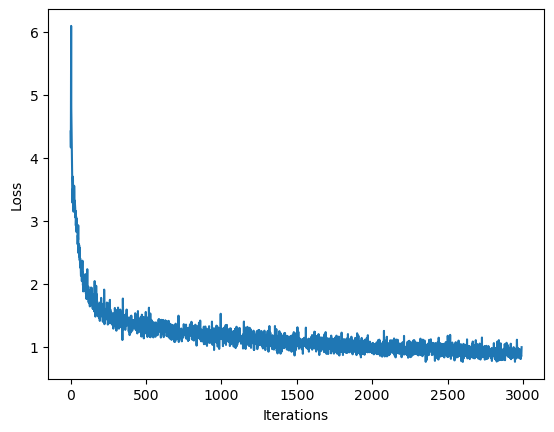

100%|███████████████████████████████████████| 3000/3000 [06:46<00:00,  7.38it/s]


True

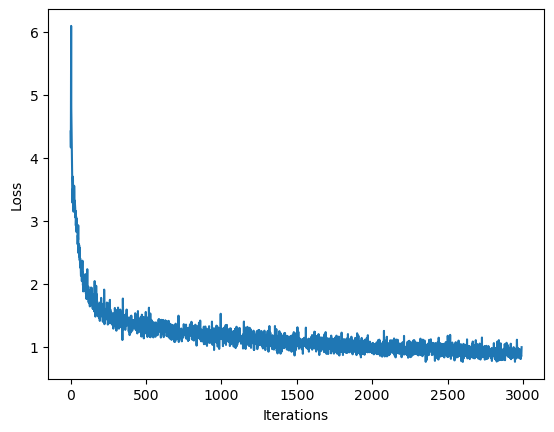

In [21]:
### Define optimizer and training operation ###

'''instantiate a new model for training using the `build_model`
  function and the hyperparameters created above.'''
model = build_model(vocab_size, params['embedding_dim'], params['rnn_units'], params['batch_size'])

'''instantiate an optimizer with its learning rate.
  Checkout the tensorflow website for a list of supported optimizers.
  https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/
  Try using the Adam optimizer to start.'''
optimizer = tf.keras.optimizers.Adam(
    learning_rate=params['learning_rate'],
    name='adam',
)

@tf.function
def train_step(x, y):
  # Use tf.GradientTape()
  with tf.GradientTape() as tape:

    '''feed the current input into the model and generate predictions'''
    y_hat = model(x)

    '''compute the loss!'''
    loss = compute_loss(y, y_hat)

  # Now, compute the gradients
  '''complete the function call for gradient computation.
      Remember that we want the gradient of the loss with respect all
      of the model parameters.
      HINT: use `model.trainable_variables` to get a list of all model
      parameters.'''
  grads = tape.gradient(loss, model.trainable_variables)

  # Apply the gradients to the optimizer so it can update the model accordingly
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss

##################
# Begin training!#
##################

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
experiment = create_experiment()

if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists
for iter in tqdm(range(params["num_training_iterations"])):

  # Grab a batch and propagate it through the network
  x_batch, y_batch = get_batch(vectorized_songs, params["seq_length"], params["batch_size"])
  loss = train_step(x_batch, y_batch)

  # log the loss to the Comet interface! we will be able to track it there.
  experiment.log_metric("loss", loss.numpy().mean(), step=iter)
  # Update the progress bar and also visualize within notebook
  history.append(loss.numpy().mean())
  plotter.plot(history)

  # Update the model with the changed weights!
  if iter % 100 == 0:
    model.save_weights(checkpoint_prefix)

# Save the trained model and the weights
model.save_weights(checkpoint_prefix)
experiment.flush()

In [22]:
'''TODO: Rebuild the model using a batch_size=1'''
model = build_model(vocab_size, params['embedding_dim'], params['rnn_units'], batch_size=1)

# Restore the model weights for the last checkpoint after training
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_2 (Embedding)     (1, None, 256)            21248     
                                                                 
 lstm_2 (LSTM)               (1, None, 1024)           5246976   
                                                                 
 dense_2 (Dense)             (1, None, 83)             85075     
                                                                 
Total params: 5353299 (20.42 MB)
Trainable params: 5353299 (20.42 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [23]:
### Prediction of a generated song ###

def generate_text(model, start_string, generation_length=1000):
  # Evaluation step (generating ABC text using the learned RNN model)

  '''TODO: convert the start string to numbers (vectorize)'''
  input_eval = [char2idx[s] for s in start_string]
  input_eval = tf.expand_dims(input_eval, 0)

  # Empty string to store our results
  text_generated = []

  # Here batch size == 1
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      '''TODO: evaluate the inputs and generate the next character predictions'''
      predictions = model(input_eval)
    
      # Remove the batch dimension
      predictions = tf.squeeze(predictions, 0)

      '''TODO: use a multinomial distribution to sample'''
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()

      # Pass the prediction along with the previous hidden state
      #   as the next inputs to the model
      input_eval = tf.expand_dims([predicted_id], 0)
    
      '''TODO: add the predicted character to the generated text!'''
      # Hint: consider what format the prediction is in vs. the output
      text_generated.append(idx2char[predicted_id])


  return (start_string + ''.join(text_generated))

In [24]:
# ''TODO: Use the model and the function defined above to generate ABC format text of length 1000!
# As you may notice, ABC files start with "X" - this may be a good start string.'''
generated_text = generate_text(model, start_string="X: ", generation_length=1000)

100%|██████████████████████████████████████| 1000/1000 [00:06<00:00, 144.44it/s]


In [25]:
print(generated_text)

X: q(__D2GF G2:|!
z|d^c def|gfg bgb|afd ege|dBG Bcd:|!
ede gfg|ege dBA|BGE DEG|cAF GFG|!
FGF E2e|fdc d2:|!
f|afd dce|d2e fdc|dAF DFA|dfe d3|!
g3 a3|baf g3|afd|!
efg faf|def gfg|aff gfg|af ede|fdf ede|faf ged|!
eaa Aab|ged cAA|fAA A2d|!
e2c def|gfg e2d|cAF G3|ABc def|!
gdB G2A|BGF G2:|!

X:6
T:Bill Houghes
Z: id:dc-reel-353
M:C
L:1/8
K:G Major
GE|DGG2 ABcA|BGEF G2Bc|dgdB dBAF|DEGA BGG2|!
Bdgd Bdgd|Bdgd BGG2|Adde fegf|efed Bcde|ABGA Bd:|!
Ad|fAA fAA gfa|gfe faa|fed egf|efe d2:|!
f|afd faf|def gfe|afd efa|baf afd|efg eaa|bab efge|!
d2fd dBGF|ABcA BGG2|Ad^c d2e|Ad^c d3:|!

X:369
T:Swallow's Her
Z: id:dc-jig-23
M:6/8
L:1/8
K:G Major
(3DEF|G2AB cBAG|AdcA GfeA|dcAG FDEC|!
a2fa g2fg|afd2 fefg|afaf bfaf|dfaf bagf|efga bgfg|!
eccB A2fg|affe fBB2|fBB2 fgfe|dfeg fdec|[1 d'2
M:6/8
L:1/8
K:G Major
D|GBd g3|afd gdB|A3 d Add|dBG G2|]!

X:135
T:Tom SheAf|gfed BdA|]!

X:69
T:Droppeab
Z: id:dc-jig-138
M:6/8
L:1/8
K:G Major
DEG2|AddB AGED|GBAG FDD:|!
B|dfd dgb bag|def gfg|ege dBA|B2d def|gbg gfe|fed BdB|A

In [26]:
### Play back generated songs ###

generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs):
  # Synthesize the waveform from a song
  waveform = mdl.lab1.play_song(song)

  # If its a valid song (correct syntax), lets play it!
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

    numeric_data = np.frombuffer(waveform.data, dtype=np.int16)
    wav_file_path = f"output_{i}.wav"
    write(wav_file_path, 88200, numeric_data)

    # save your song to the Comet interface -- you can access it there
    experiment.log_asset(wav_file_path)

rm: tmp.mid: No such file or directory


Found 4 songs in text
4.92 April 30 2024 abc2midi
Error in line-char 0-0 : Missing Number
Warning in line-char 2-0 : Ignoring text: z|d^c def|gfg bgb|afd ege|dBG Bcd:|!
Warning in line-char 3-0 : Ignoring text: ede gfg|ege dBA|BGE DEG|cAF GFG|!
Warning in line-char 4-0 : Ignoring text: FGF E2e|fdc d2:|!
Warning in line-char 5-0 : Ignoring text: f|afd dce|d2e fdc|dAF DFA|dfe d3|!
Warning in line-char 6-0 : Ignoring text: g3 a3|baf g3|afd|!
Warning in line-char 7-0 : Ignoring text: efg faf|def gfg|aff gfg|af ede|fdf ede|faf ged|!
Warning in line-char 8-0 : Ignoring text: eaa Aab|ged cAA|fAA A2d|!
Warning in line-char 9-0 : Ignoring text: e2c def|gfg e2d|cAF G3|ABc def|!
Warning in line-char 10-0 : Ignoring text: gdB G2A|BGF G2:|!
Error in line-char 11-0 : No valid K: field found at start of tune
Playing tmp.mid
MIDI file: tmp.mid
tmp.mid: No such file or directory
Playing tmp.wav
MIDI file: tmp.wav
tmp.wav: Not a MIDI file!
4.92 April 30 2024 abc2midi
Warning in line-char 12-38 : Assumin

4.92 April 30 2024 abc2midi
Error in line-char 14-34 :  found [1 or like before |:
Warning in line-char 14-34 : Assuming repeat
writing MIDI file tmp.mid
Warning in line-char 7-15 : Track 0 Bar 1 has 8 time units while the time signature has 6
Warning in line-char 7-25 : Track 0 Bar 2 has 8 time units while the time signature has 6
Warning in line-char 7-35 : Track 0 Bar 3 has 8 time units while the time signature has 6
Warning in line-char 8-9 : Track 0 Bar 4 has 8 time units while the time signature has 6
Warning in line-char 8-19 : Track 0 Bar 5 has 8 time units while the time signature has 6
Warning in line-char 8-29 : Track 0 Bar 6 has 8 time units while the time signature has 6
Warning in line-char 8-39 : Track 0 Bar 7 has 8 time units while the time signature has 6
Warning in line-char 8-49 : Track 0 Bar 8 has 8 time units while the time signature has 6
Warning in line-char 9-9 : Track 0 Bar 9 has 8 time units while the time signature has 6
Warning in line-char 9-19 : Track 0 Ba

4.92 April 30 2024 abc2midi
Error in line-char 3-0 : No valid K: field found at start of tune
Playing tmp.mid
MIDI file: tmp.mid
tmp.mid: No such file or directory
Playing tmp.wav
MIDI file: tmp.wav
tmp.wav: Not a MIDI file!


rm: tmp.mid: No such file or directory
